In [157]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import scipy.stats as stats
import researchpy as rp
from statsmodels.stats.outliers_influence import variance_inflation_factor
from scipy.stats import chi2_contingency 
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

In [162]:
df = pd.read_csv("fin.csv")
df

,Fare,distance,passenger_count,year,Month,Date,Hour,Minute,Second
0,4.5,1.030765,1.0,2009,6,15,17,26,21
1,16.9,8.450145,1.0,2010,1,5,16,52,16
2,5.7,1.389527,2.0,2011,8,18,0,35,0
3,7.7,2.799274,1.0,2012,4,21,4,30,42
4,5.3,1.999160,1.0,2010,3,9,7,51,0
...,...,...,...,...,...,...,...,...,...
15580,6.5,0.850046,1.0,2014,12,12,7,41,0
15581,16.1,7.867649,2.0,2009,7,13,7,58,0
15582,8.5,1.469108,1.0,2009,11,11,11,19,7
15583,8.1,2.590040,1.0,2010,5,11,23,53,0


In [169]:
nmap = pd.read_csv("train_cab.csv")
# Map Styles - cartodbpositron, cartodbdark_matter
# Color - #08d9d6, #ff2e63
drop_map = folium.Map(location = [40.780723, -73.96157], tiles='cartodbdark_matter', zoom_start = 11)

for index, row in nmap.iterrows():
    folium.CircleMarker([row['dropoff_latitude'], row['dropoff_longitude']],
                        radius=3,
                        color="#00A7E1", 
                        fill_opacity=0.9
                       ).add_to(drop_map)

for index, row in nmap.iterrows():
    folium.CircleMarker([row['pickup_latitude'], row['pickup_longitude']],
                        radius=3,
                        color="#FFFFFF", 
                        fill_opacity=0.9
                       ).add_to(drop_map)

drop_map

#### Dependent Variable - Fare
#### Independent Variables - pickup_longitude, pickup_latitude, dropoff_longitude, dropoff_latitude, distance, passenger_count, year	Month, Date, Day, Hour, Minute

#### Correlation Analysis

<AxesSubplot:>

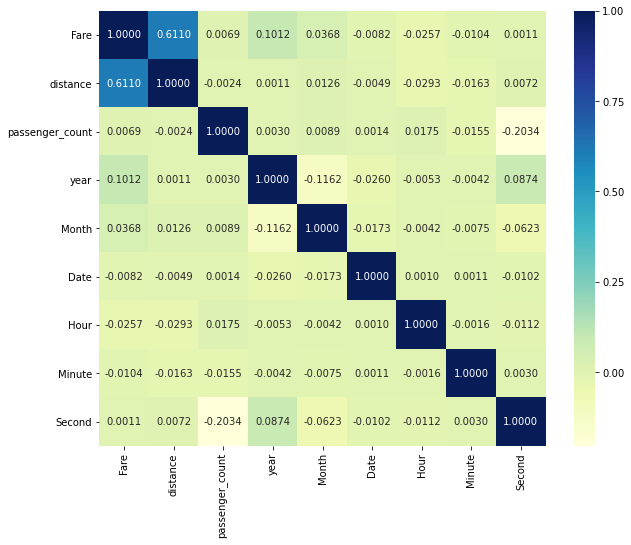

In [15]:
### Correlation 
plt.subplots(figsize=(10,8))
sns.heatmap(df.corr(), annot=True, fmt='.4f', cmap="YlGnBu")

#### Multicollinearity Test

In [26]:
def calc_vif(X):
    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    return(vif)

In [29]:
X = df
calc_vif(X)

,variables,VIF
0,Fare,3.418065
1,distance,2.494577
2,passenger_count,2.826142
3,year,19.441151
4,Month,4.328410
5,Date,4.258776
6,Hour,5.313276
7,Minute,3.942008
8,Second,1.770528


We found that 'year' is a highly correlated variable

#### Oneway ANOVA (Analysis of Variance) Test

<AxesSubplot:>

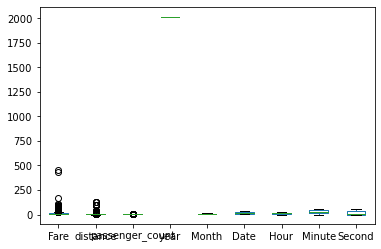

In [30]:
df.boxplot(column=['Fare', 'distance', 'passenger_count', 'year', 'Month', 'Date', 'Hour', 'Minute', 'Second'], grid=False)

In [160]:
fvalue, pvalue = stats.f_oneway(df['Fare'], df['distance'], df['passenger_count'], df['year'], df['Month'], df['Date'], df['Hour'], df['Minute'], df['Second'])
print(fvalue, pvalue)

65764555.29550723 0.0


The p value obtained from ANOVA analysis is significant (p < 0.05), and therefore, we conclude that there are significant differences among treatments.

In [46]:
rp.summary_cont(df['Fare'])

,Variable,N,Mean,SD,SE,95% Conf.,Interval
0,Fare,15585.0,11.3556,10.6438,0.0853,11.1885,11.5227


#### Pearsons Correlation Test

In [53]:
# The 3 return DataFrames are information, r values, and p-values
i, r, p  = rp.correlation.corr_case(df)
i

,Pearson correlation test using list-wise deletion
0,Total observations used = 15585


In [54]:
r

,Fare,distance,passenger_count,year,Month,Date,Hour,Minute,Second
Fare,1,0.611,0.0069,0.1012,0.0368,-0.0082,-0.0257,-0.0104,0.0011
distance,0.611,1,-0.0024,0.0011,0.0126,-0.0049,-0.0293,-0.0163,0.0072
passenger_count,0.0069,-0.0024,1,0.003,0.0089,0.0014,0.0175,-0.0155,-0.2034
year,0.1012,0.0011,0.003,1,-0.1162,-0.026,-0.0053,-0.0042,0.0874
Month,0.0368,0.0126,0.0089,-0.1162,1,-0.0173,-0.0042,-0.0075,-0.0623
Date,-0.0082,-0.0049,0.0014,-0.026,-0.0173,1,0.001,0.0011,-0.0102
Hour,-0.0257,-0.0293,0.0175,-0.0053,-0.0042,0.001,1,-0.0016,-0.0112
Minute,-0.0104,-0.0163,-0.0155,-0.0042,-0.0075,0.0011,-0.0016,1,0.003
Second,0.0011,0.0072,-0.2034,0.0874,-0.0623,-0.0102,-0.0112,0.003,1


In [55]:
p

,Fare,distance,passenger_count,year,Month,Date,Hour,Minute,Second
Fare,0.0000,0.0000,0.3913,0.0000,0.0000,0.3074,0.0013,0.1958,0.8919
distance,0.0000,0.0000,0.7621,0.8870,0.1167,0.5426,0.0003,0.0424,0.3672
passenger_count,0.3913,0.7621,0.0000,0.7046,0.2649,0.8620,0.0286,0.0536,0.0000
year,0.0000,0.8870,0.7046,0.0000,0.0000,0.0012,0.5060,0.5992,0.0000
Month,0.0000,0.1167,0.2649,0.0000,0.0000,0.0312,0.5959,0.3460,0.0000
Date,0.3074,0.5426,0.8620,0.0012,0.0312,0.0000,0.9007,0.8904,0.2042
Hour,0.0013,0.0003,0.0286,0.5060,0.5959,0.9007,0.0000,0.8412,0.1621
Minute,0.1958,0.0424,0.0536,0.5992,0.3460,0.8904,0.8412,0.0000,0.7072
Second,0.8919,0.3672,0.0000,0.0000,0.0000,0.2042,0.1621,0.7072,0.0000


#### Chi-Square Test

In [16]:
# defining the table 
stat, p, dof, expected = chi2_contingency(df) 
  
# interpret p-value 
alpha = 0.05
print("p value is " + str(p)) 
if p <= alpha: 
    print('Dependent (reject H0)') 
else: 
    print('Independent (H0 holds true)') 

p value is 0.0
Dependent (reject H0)


Since, p-value > alpha
Therefore, we reject H0, that is, the variables do have significant relationship.

#### Mean distance & fare per passenger_count

In [74]:
df.groupby('passenger_count')['distance', 'Fare'].mean()

C:\Users\akshay\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


,distance,Fare
passenger_count,,
1.0,3.400737,11.166711
2.0,3.689322,12.304289
3.0,3.403373,11.536717
4.0,3.460241,11.406254
5.0,3.366525,11.078368
6.0,3.102106,11.407966


#### Average USD per KM

In [75]:
print("Average $USD/KM : {:0.2f}".format(df.Fare.sum()/df.distance.sum()))

Average $USD/KM : 3.30


#### Countplot for passenger_count

<AxesSubplot:xlabel='passenger_count', ylabel='count'>

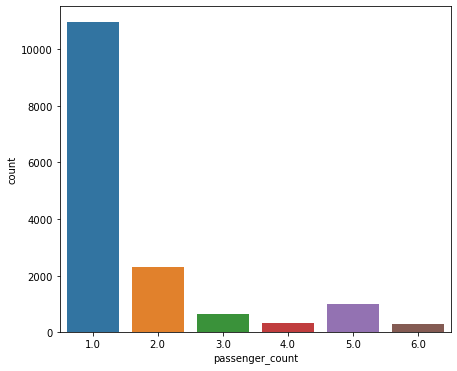

In [55]:
plt.figure(figsize=(7,6))
sns.countplot(x="passenger_count", data=df)

By seeing the above plots we can easily conclude that:

single travelling passengers are most frequent travellers.
At the sametime we can also conclude that highest Fare are coming from single & double travelling passengers.

#### Trips Hourly Analysis

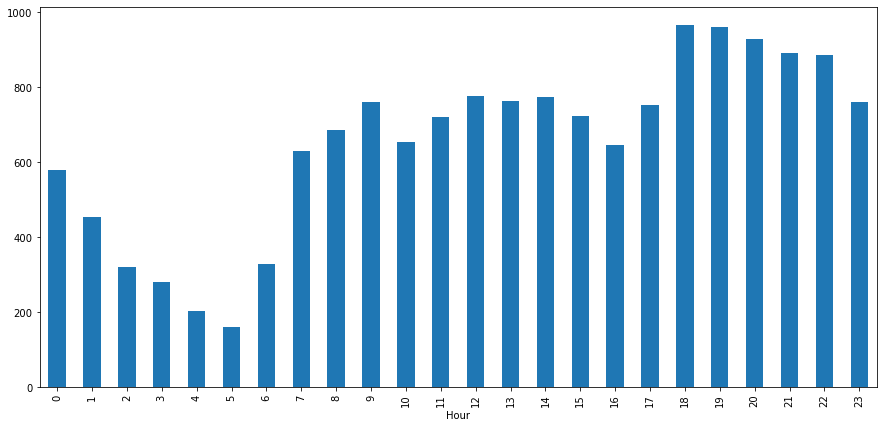

In [38]:
plt.figure(figsize=(15,7))
df.groupby(df["Hour"])['Hour'].count().plot(kind="bar")
plt.show()

Lowest cabs at 5 AM and highest at and around 7 PM i.e the office rush hours



#### Countplot for year wise and month wise trips

<AxesSubplot:xlabel='Month', ylabel='count'>

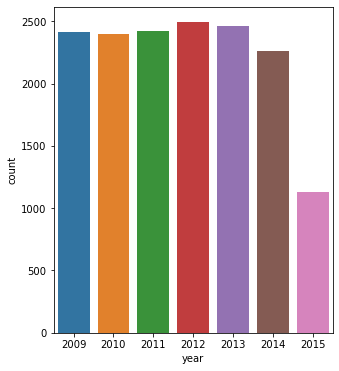

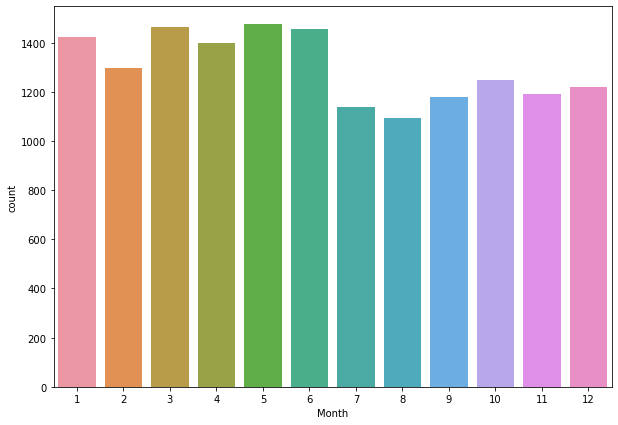

In [56]:
plt.figure(figsize=(5,6))
sns.countplot(df['year'])
# plt.savefig('year.png')

plt.figure(figsize=(10,7))
sns.countplot(df['Month'])
# plt.savefig('month.png')

No Affect of Year & Month

#### Jointplot

Jointplots for Bivariate Analysis.


Here Scatter plot has regression line between 2 variables along with separate Bar plots of both variables.


Also its annotated with pearson correlation coefficient and p value.

#### Jointplot for distance and fare

C:\Users\akshay\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


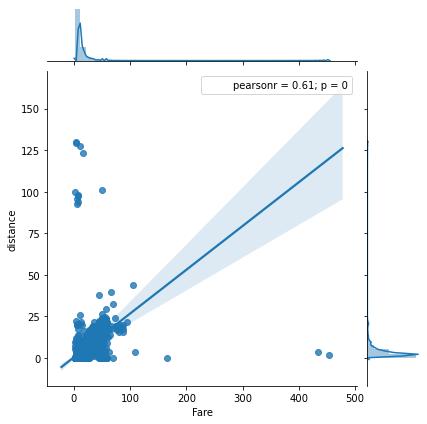

In [82]:
sns.jointplot(x='Fare',y='distance',data=df,kind = 'reg').annotate(stats.pearsonr)
# plt.savefig('jointfplo.png')
plt.show()

#### Zoomed Scatterplot of Fare vs Distance

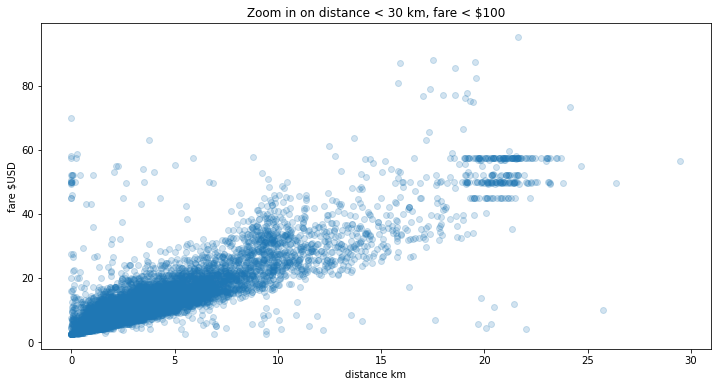

In [112]:
plt.subplots(figsize=(12,6))
idx = (df.distance < 30) & (df.Fare < 100)
plt.scatter(df[idx].distance, df[idx].Fare, alpha=0.2)
plt.xlabel('distance km')
plt.ylabel('fare $USD')
plt.title('Zoom in on distance < 30 km, fare < $100');

#### Jointplot for passenger_count and Fare

C:\Users\akshay\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


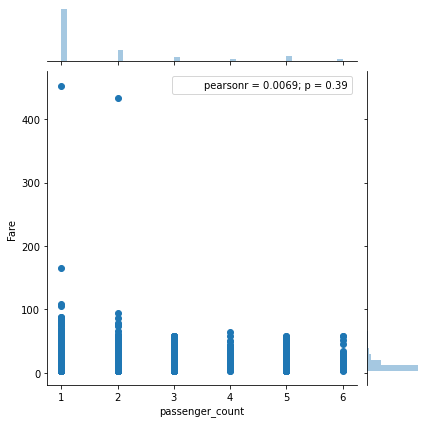

In [105]:
sns.jointplot(x='passenger_count',y='Fare',data=df).annotate(stats.pearsonr)
# plt.savefig('jointfplo.png')
plt.show()

#### Jointplot for year and Fare

C:\Users\akshay\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


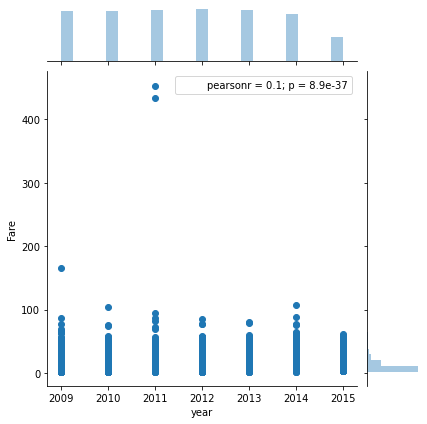

In [136]:
sns.jointplot(x='year',y='Fare',data=df).annotate(stats.pearsonr)
# plt.savefig('jointfplo.png')
plt.show()

#### Jointplot for Month and Fare

C:\Users\akshay\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


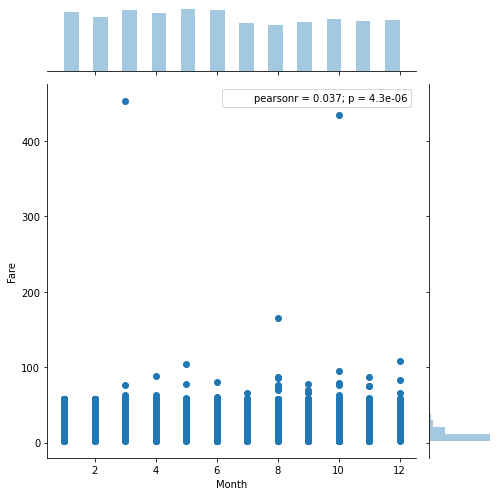

In [129]:
sns.jointplot(x='Month',y='Fare',data=df, height=7).annotate(stats.pearsonr)
# plt.savefig('jointfplo.png')
plt.show()

#### Jointplot for Date and Fare

C:\Users\akshay\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


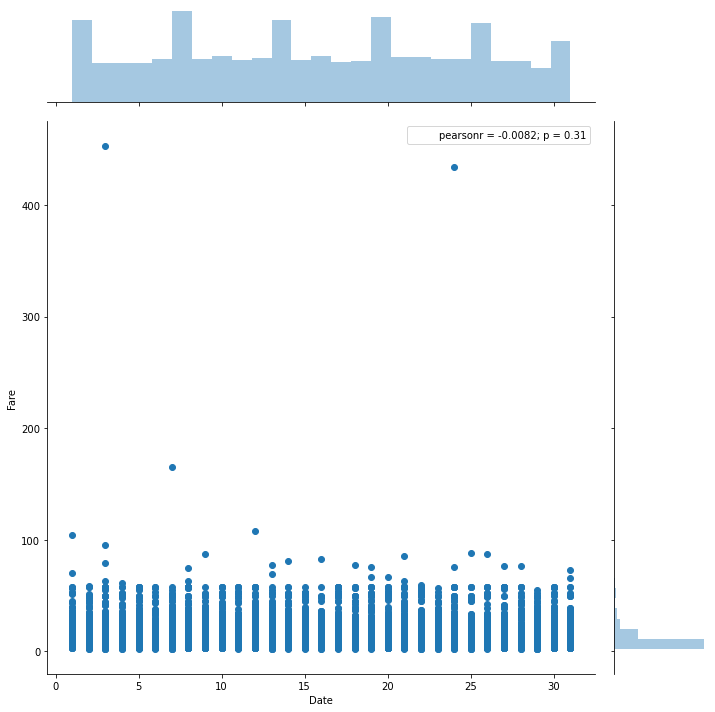

In [123]:
sns.jointplot(x='Date',y='Fare',data=df, height=10).annotate(stats.pearsonr)
# plt.savefig('jointfplo.png')
plt.show()

#### Jointplot for Hour and Fare

C:\Users\akshay\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


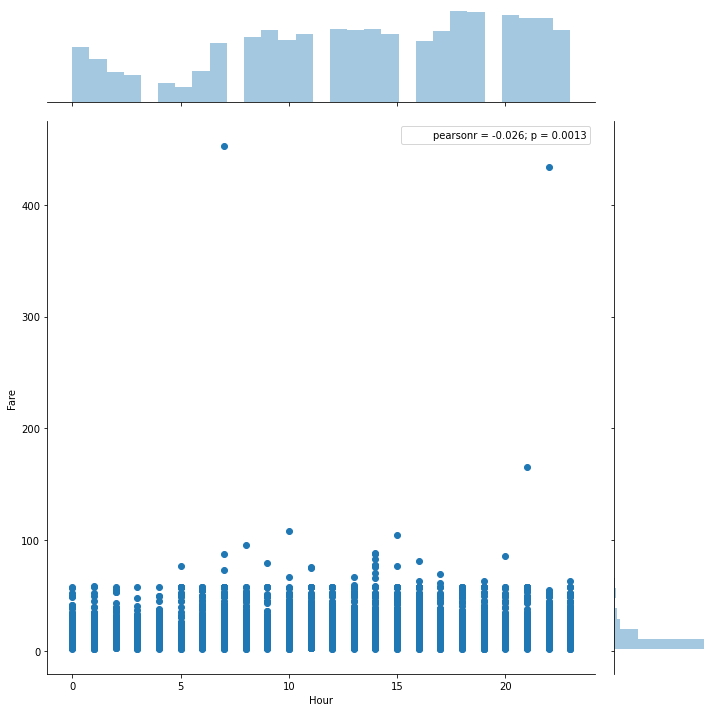

In [126]:
sns.jointplot(x='Hour',y='Fare',data=df, height=10).annotate(stats.pearsonr)
# plt.savefig('jointfplo.png')
plt.show()

#### Seasonality Analysis 

In [142]:
def time_slicer(df, timeframes, value, color="purple"):
    """
    Function to count observation occurrence through different lenses of time.
    """
    f, ax = plt.subplots(len(timeframes), figsize = [12,8])
    for i,x in enumerate(timeframes):
        df.loc[:,[x,value]].groupby([x]).mean().plot(ax=ax[i],color=color)
        ax[i].set_ylabel(value.replace("_", " ").title())
        ax[i].set_title("{} by {}".format(value.replace("_", " ").title(), x.replace("_", " ").title()))
        ax[i].set_xlabel("")
    ax[len(timeframes)-1].set_xlabel("Time Frame")
    plt.tight_layout(pad=0)

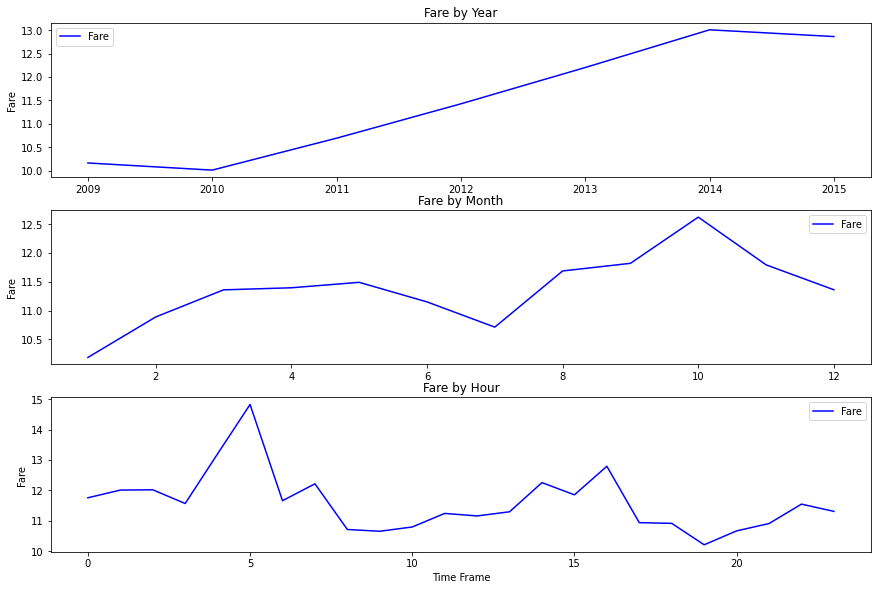

In [143]:
time_slicer(df=df, timeframes=['year', "Month", "Hour"], value = "Fare", color="blue")

Surge Fare at 5 AM and 4-5 PM office goers

Text(0.5, 1.0, 'Avg Fare Amount over Years')

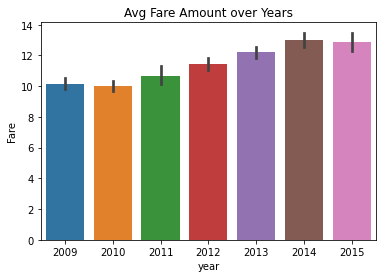

In [147]:
sns.barplot(x='year',y='Fare',data=df).set_title("Avg Fare Amount over Years")

Text(0.5, 1.0, 'Avg Fare Amount over Years')

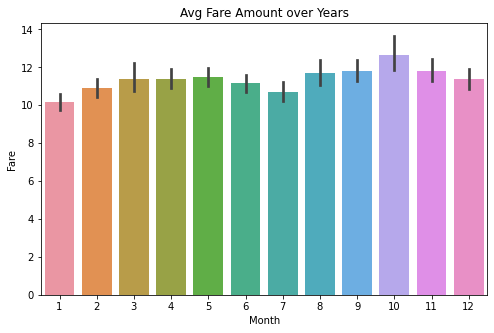

In [152]:
plt.figure(figsize=(8,5))
sns.barplot(x='Month',y='Fare',data=df).set_title("Avg Fare Amount over Years")

Text(0.5, 1.0, 'Avg Fare Amount over Years')

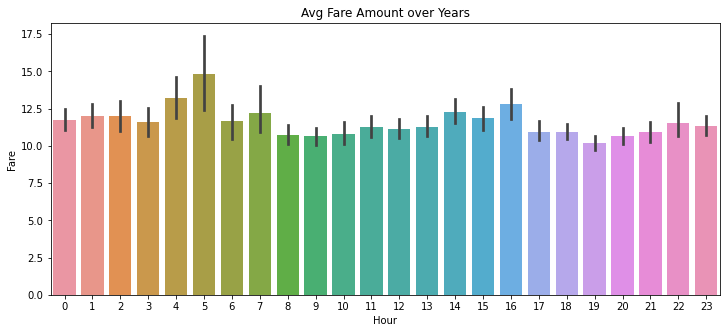

In [151]:
plt.figure(figsize=(12,5))
sns.barplot(x='Hour',y='Fare',data=df).set_title("Avg Fare Amount over Years")

#### Normality check for Fare

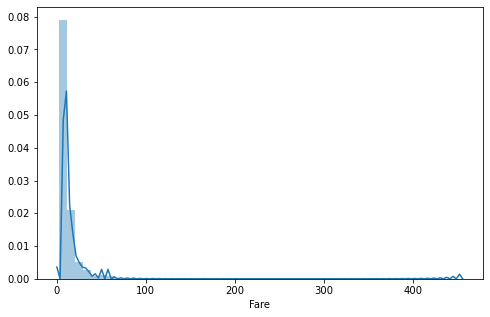

In [154]:
plt.figure(figsize=(8,5))
sns.distplot(df['Fare'])
plt.show()

#### Normality check for Fare after Log Transform

Text(0.5, 1.0, 'Distribution of Fare (log scale)')

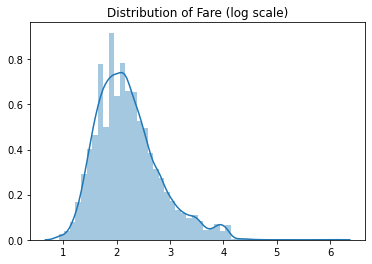

In [165]:
sns.distplot(np.log(df['Fare'].values)).set_title("Distribution of Fare (log scale)")

#### Normality check for Distance

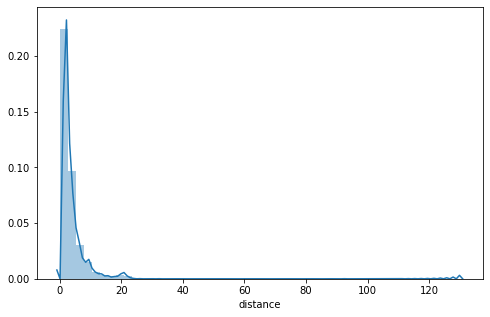

In [166]:
plt.figure(figsize=(8,5))
sns.distplot(df['distance'])
plt.show()

#### Normality check for Distance after Log Transform

Text(0.5, 1.0, 'Distribution of Distance (log scale)')

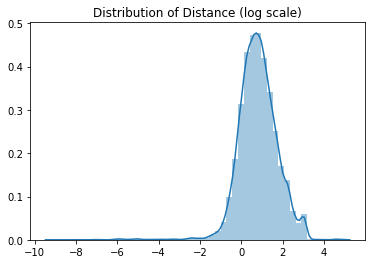

In [167]:
sns.distplot(np.log(df['distance'].values)).set_title("Distribution of Distance (log scale)")